<a href="https://colab.research.google.com/github/bani1610/Machine-Learning-Praktikum/blob/main/Praktikum11/Notebook/Tugas11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip install folium
!pip install contextily

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import HeatMap
import geopandas as gpd
import contextily
from mpl_toolkits.axes_grid1 import make_axes_locatable
from shapely import wkt

In [23]:
df = pd.read_csv('/content/drive/MyDrive/praktikum-ml/Praktikum11/data/combine_tije_opendata_cleaned.csv', sep=';')

In [89]:
df.head()

,route_id,route_long_name,route_color,trip_id,service_id,direction_id,stop_sequence,stop_name,stop_lat,stop_lon,location_type,shape_pt_sequence,shape_id
0,1,Blok M - Kota,D62126,1-R07,SH,0,0,Blok M,-6.243312,106.801750,0,1,usj3
1,1,Blok M - Kota,D62126,1-R08,SH,1,0,Kali Besar Barat,-6.135355,106.811430,0,1,mlcx
2,1,Blok M - Kota,D62126,1-R07,SH,0,1,Asean,-6.239911,106.798970,0,1,usj3
3,1,Blok M - Kota,D62126,1-R08,SH,1,1,Museum Fatahillah,-6.133882,106.812140,0,1,mlcx
4,1,Blok M - Kota,D62126,1-R08,SH,1,2,Kota,-6.136827,106.814876,0,1,mlcx


In [57]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24663 entries, 0 to 24662
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   route_id           24663 non-null  object 
 1   route_long_name    24663 non-null  object 
 2   route_color        24663 non-null  object 
 3   trip_id            24663 non-null  object 
 4   service_id         24663 non-null  object 
 5   direction_id       24663 non-null  int64  
 6   stop_sequence      24663 non-null  int64  
 7   stop_name          24663 non-null  object 
 8   stop_lat           24663 non-null  float64
 9   stop_lon           24663 non-null  float64
 10  location_type      24663 non-null  int64  
 11  shape_pt_sequence  24663 non-null  int64  
 12  shape_id           24663 non-null  object 
dtypes: float64(2), int64(4), object(7)
memory usage: 2.4+ MB


In [12]:
df_clean = df[['stop_name', 'stop_lat', 'stop_lon']].dropna()

In [13]:
df_spatial = df_clean.drop_duplicates(subset=['stop_lat', 'stop_lon']).reset_index(drop=True)

In [14]:
coords = df_spatial[['stop_lat', 'stop_lon']].values
coords_rad = np.radians(coords)

In [16]:
print(f"Data awal: {len(df)} baris")
print(f"Data unik (Lokasi Halte): {len(df_spatial)} baris")

Data awal: 24663 baris
Data unik (Lokasi Halte): 7123 baris


In [25]:
peta_jabodetabek = folium.Map(location=[-6.2, 106.8], zoom_start=11)

df_jabo = df[
    (df['stop_lat'] >= -6.8) & (df['stop_lat'] <= -5.7) & # Corrected 'latitude' to 'stop_lat'
    (df['stop_lon'] >= 106.5) & (df['stop_lon'] <= 107.1) # Corrected 'longitude' to 'stop_lon'
]

data_heatmap = df_jabo[['stop_lat', 'stop_lon']].values.tolist() # Corrected 'latitude' and 'longitude'

HeatMap(data_heatmap, radius=12, blur=15, max_zoom=6).add_to(peta_jabodetabek)

peta_jabodetabek

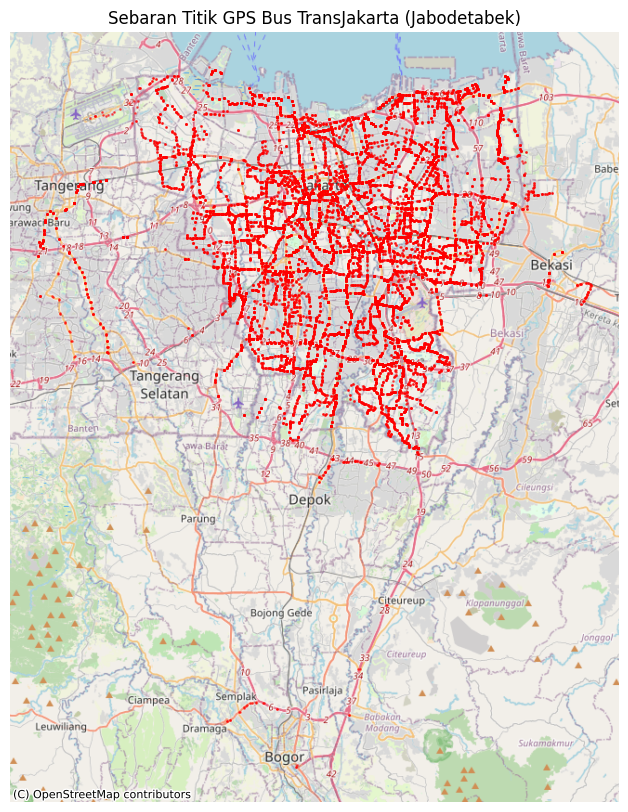

In [27]:
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt
import contextily as ctx

# Filter Jabodetabek agar peta fokus
df_jabo = df[
    (df['stop_lat'] >= -6.8) & (df['stop_lat'] <= -5.7) & # Corrected column name
    (df['stop_lon'] >= 106.5) & (df['stop_lon'] <= 107.1) # Corrected column name
]

# Buat geometri point dari lat & lon
geometry = [Point(xy) for xy in zip(df_jabo['stop_lon'], df_jabo['stop_lat'])] # Corrected column names
gdf = gpd.GeoDataFrame(df_jabo, geometry=geometry, crs="EPSG:4326")

# Konversi ke Web Mercator agar cocok dengan basemap
gdf = gdf.to_crs(epsg=3857)

# Plot peta titik GPS
fig, ax = plt.subplots(figsize=(10,10))
gdf.plot(ax=ax, markersize=1, alpha=0.5, color='red')

# Tambah basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

ax.set_title("Sebaran Titik GPS Bus TransJakarta (Jabodetabek)")
ax.set_axis_off()
plt.show()

In [71]:
from scipy.stats import shapiro

normalisasiTest = df_jabo[['stop_lat', 'stop_lon']]
normalisasiTest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24663 entries, 0 to 24662
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   stop_lat  24663 non-null  float64
 1   stop_lon  24663 non-null  float64
dtypes: float64(2)
memory usage: 385.5 KB


In [72]:
stat, p = shapiro(normalisasiTest)
print('stat=%.3f, p=%.3f' % (stat, p))

stat=0.638, p=0.000


/usr/local/lib/python3.12/dist-packages/scipy/stats/_axis_nan_policy.py:579: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 49326.
  res = hypotest_fun_out(*samples, **kwds)


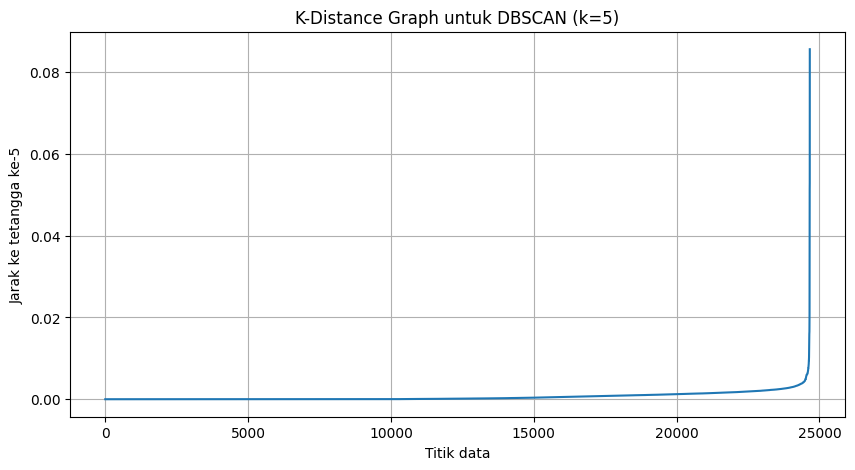

In [82]:
from sklearn.neighbors import NearestNeighbors
import numpy as np
import matplotlib.pyplot as plt

coords_sample = df_jabo[['stop_lat','stop_lon']].values[:100000]

# Tentukan k = min_samples (5)
neighbors = NearestNeighbors(n_neighbors=5)
neighbors_fit = neighbors.fit(coords_sample)
distances, indices = neighbors_fit.kneighbors(coords_sample)

# Sort distance ascending buat lihat titik belokan (elbow)
distances = np.sort(distances[:, 4])  # index 4 karena k=5

plt.figure(figsize=(10, 5))
plt.plot(distances)
plt.title("K-Distance Graph untuk DBSCAN (k=5)")
plt.xlabel("Titik data")
plt.ylabel("Jarak ke tetangga ke-5")
plt.grid(True)
plt.show()


In [86]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

# Model DBSCAN SAMPLE
dbscan_sample = DBSCAN(eps=0.0013, min_samples=5)
labels_sample = dbscan_sample.fit_predict(coords_sample)

# Hitung Silhouette Score (cluster valid minimal 2 cluster)
unique_labels = set(labels_sample)
if len(unique_labels) > 1:
    sil_score = silhouette_score(coords_sample, labels_sample)
    print("Silhouette Score:", sil_score)
else:
    print("Silhouette Score tidak dapat dihitung (hanya 1 cluster)")


Silhouette Score: 0.4414831445221813


/tmp/ipython-input-3770611531.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("tab20", len(unique_labels))


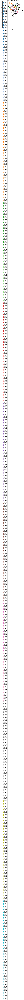

In [87]:
import matplotlib.pyplot as plt
import numpy as np

unique_labels = np.unique(labels_sample)
colors = plt.cm.get_cmap("tab20", len(unique_labels))

plt.figure(figsize=(8, 10))
for label in unique_labels:
    mask = labels_sample == label
    if label == -1:
        plt.scatter(coords_sample[mask, 1], coords_sample[mask, 0], s=2, c='black', label='Noise')
    else:
        plt.scatter(coords_sample[mask, 1], coords_sample[mask, 0], s=2, c=[colors(label)], label=f'Cluster {label}')

plt.title("Visualisasi Cluster DBSCAN (Sample Data)")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True)
plt.legend(markerscale=5)
plt.show()


In [ ]:
import folium
from folium.plugins import MarkerCluster

# Map Jabodetabek
peta_cluster = folium.Map(location=[-6.2, 106.8], zoom_start=11)

# Warna untuk cluster
def get_color(label):
    if label == -1:
        return 'black'  # noise
    return f'#{hex((label * 1234567) % 0xFFFFFF)[2:].zfill(6)}'

# Tambah marker cluster
marker_cluster = MarkerCluster().add_to(peta_cluster)

for lat, lon, label in zip(df_jabo['stop_lat'][:100000], df_jabo['stop_lon'][:100000], labels_sample):
    folium.CircleMarker(
        location=[lat, lon],
        radius=1.5,
        color=get_color(label),
        fill=True,
        fill_opacity=0.9,
    ).add_to(marker_cluster)

peta_cluster

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


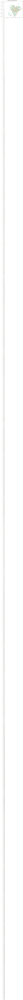

In [67]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
coords_pca = pca.fit_transform(coords_sample)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=coords_pca[:, 0], y=coords_pca[:, 1], hue=labels_sample, palette="Set2")
plt.title("Visualisasi Cluster DBSCAN (PCA)")
plt.show()

In [68]:
def klasifikasi_db(x):
  if x == 0:
    return "baik"
  elif x == -1:
    return "Noise"
  else:
    return "kurang baik"

# Add the DBSCAN cluster labels to df_jabo
df_jabo['Cluster_DBSCAN'] = labels_sample

# Apply the classification function to the new column in df_jabo
df_jabo['Klasifikasi_DBSCAN'] = df_jabo['Cluster_DBSCAN'].apply(klasifikasi_db)

print(df_jabo['Klasifikasi_DBSCAN'].value_counts())

Klasifikasi_DBSCAN
kurang baik    20580
Noise           3991
baik              92
Name: count, dtype: int64


In [91]:
import folium

# Initialize peta_dbscan if it's not already defined
peta_dbscan = folium.Map(location=[-6.2, 106.8], zoom_start=11)

# Define the color_point function
def color_point(label):
    if label == -1:
        return 'black'  # Noise points
    # Generate a unique color for each cluster
    # Using a simple hash-based approach for distinct colors
    return f'#{hex((label * 1234567) % 0xFFFFFF)[2:].zfill(6)}'

for lat, lon, label in zip(df_jabo['stop_lat'], df_jabo['stop_lon'], labels_sample):
    folium.CircleMarker(
        location=[lat, lon],
        radius=2,
        color=color_point(label),
        fill=True,
        fill_color=color_point(label),
        fill_opacity=0.7
    ).add_to(peta_dbscan)

peta_dbscan